In [1]:
%pip install decorator==5.0.9

import imp
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt
import networkx as nx

Note: you may need to restart the kernel to use updated packages.


In [2]:
# importing local modules

import sys
sys.path.append('../src/')

import text_cleanup.text_cleanup as thesisCleanUp
import preprocessing.text_preprocessing as thesisTextPreprocessing
import data.reader as thesisDataReader
import utils.utils as thesisUtils

imp.reload(thesisCleanUp)
imp.reload(thesisTextPreprocessing)
imp.reload(thesisDataReader)
imp.reload(thesisUtils)

<module 'utils.utils' from '../src/utils/utils.py'>

In [3]:
a_zwickau_text = thesisDataReader.read_a_zwickau()
b_london_text = thesisDataReader.read_b_london()

In [4]:
a_zwickau_corpus = thesisCleanUp.create_corpus_by_line(thesisCleanUp.jvtext(a_zwickau_text))
b_london_corpus = thesisCleanUp.create_corpus_by_line(thesisCleanUp.jvtext(b_london_text))

In [5]:
a_zwickau_corpus = list(map(lambda x: x.replace(' ', ''), a_zwickau_corpus))
b_london_corpus = list(map(lambda x: x.replace(' ', ''), b_london_corpus))

In [6]:
def get_features(corpus):
    vectorizer = TfidfVectorizer(ngram_range=(3,3), analyzer='char')
    sparse_matrix = vectorizer.fit_transform(corpus)
    doc_term_matrix = sparse_matrix.todense()
    df = pd.DataFrame(doc_term_matrix, columns=vectorizer.get_feature_names())
    return df

In [7]:
a_zwickau_df = get_features(a_zwickau_corpus)
a_zwickau_similarities = cosine_similarity(a_zwickau_df, a_zwickau_df)

b_london_df = get_features(b_london_corpus)
b_london_similarities = cosine_similarity(b_london_df, b_london_df)

In [8]:
a_zwickau_df

,(11,(12,(13,(14,)10,)5l,)ad,)ba,)bo,)ca,...,zim,zip,ziu,zoe,zor,zot,zra,zuc,zur,½le
0,0.189315,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.067669,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
317,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
318,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
319,0.000000,0.0,0.0,0.029991,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
320,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [9]:
def show_similarities_data(similarities):
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        print('___ max similariry for paragraph: {} ___'.format(index))
        for i in max_indices:
            print('index: [{}] value: {}'.format(i, similarities[index][i]))
        print('average: {}'.format(np.average(value)))

        unique, counts = np.unique(value, return_counts=True)
        unique_dictionary = dict(zip(unique, counts))
        print('0 similarities: {}'.format(unique_dictionary.get(0.0)))

        print()

In [10]:
show_similarities_data(a_zwickau_similarities)

___ max similariry for paragraph: 0 ___
index: [269] value: 0.09091332844533108
index: [194] value: 0.09755556128415406
index: [280] value: 0.10560190803829256
index: [46] value: 0.125841313457635
index: [321] value: 0.14043680197878505
index: [0] value: 1.0
average: 0.03201585228754265
0 similarities: 18

___ max similariry for paragraph: 1 ___
index: [5] value: 0.34534528744851745
index: [313] value: 0.3466366292932512
index: [282] value: 0.3508780942136971
index: [280] value: 0.3776754281295073
index: [6] value: 0.3937756893640698
index: [1] value: 1.0000000000000007
average: 0.1892765680922942
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [289] value: 0.25189543671252274
index: [280] value: 0.2555143206644475
index: [282] value: 0.2566913189196612
index: [12] value: 0.26453157235396696
index: [5] value: 0.27744571312699484
index: [2] value: 1.0
average: 0.13826887669343838
0 similarities: None

___ max similariry for paragraph: 3 ___
index: [280] value: 0.305

index: [195] value: 1.0000000000000002
average: 0.11067591301246958
0 similarities: None

___ max similariry for paragraph: 196 ___
index: [297] value: 0.32060279222188587
index: [280] value: 0.33245300453797577
index: [169] value: 0.35061218860749455
index: [195] value: 0.3553483951725567
index: [227] value: 0.3908532756851757
index: [196] value: 0.9999999999999999
average: 0.18992381824419693
0 similarities: None

___ max similariry for paragraph: 197 ___
index: [318] value: 0.2644669692995657
index: [172] value: 0.29929697277854345
index: [185] value: 0.30162505846281834
index: [200] value: 0.3018160480079413
index: [184] value: 0.31490165023062566
index: [197] value: 0.9999999999999997
average: 0.15075684830285663
0 similarities: None

___ max similariry for paragraph: 198 ___
index: [64] value: 0.16383412127826807
index: [196] value: 0.16894221732263323
index: [131] value: 0.17032275282076567
index: [105] value: 0.17477710582761388
index: [134] value: 0.17736593817436694
index: [1

In [11]:
show_similarities_data(b_london_similarities)

___ max similariry for paragraph: 0 ___
index: [209] value: 0.10988018675249239
index: [317] value: 0.11263806116113044
index: [21] value: 0.11271547456282255
index: [311] value: 0.11783213235008899
index: [19] value: 0.14693384014626393
index: [0] value: 1.0000000000000002
average: 0.03176002789166956
0 similarities: 25

___ max similariry for paragraph: 1 ___
index: [305] value: 0.343622921015131
index: [5] value: 0.3464727093461076
index: [118] value: 0.34776723987830666
index: [272] value: 0.3621304632306024
index: [313] value: 0.3716690743687712
index: [1] value: 1.0000000000000004
average: 0.20394831656420812
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [275] value: 0.26471087965796103
index: [273] value: 0.26790495644419193
index: [274] value: 0.26837268139533255
index: [305] value: 0.2690044371821086
index: [5] value: 0.29596577596331514
index: [2] value: 1.0
average: 0.15237867768120478
0 similarities: 1

___ max similariry for paragraph: 3 ___
index: [

index: [205] value: 0.4023045489232427
index: [83] value: 0.9999999999999996
average: 0.23477355965781946
0 similarities: None

___ max similariry for paragraph: 84 ___
index: [88] value: 0.2335515858141302
index: [87] value: 0.25351610590204493
index: [91] value: 0.2551498233252219
index: [94] value: 0.2572121721099533
index: [83] value: 0.26949916689416903
index: [84] value: 1.0
average: 0.1414160721242746
0 similarities: None

___ max similariry for paragraph: 85 ___
index: [118] value: 0.2869794771709212
index: [86] value: 0.2923078060463164
index: [291] value: 0.29254367188445823
index: [98] value: 0.31481726551954153
index: [74] value: 0.35831550496419756
index: [85] value: 1.0
average: 0.18040662151998946
0 similarities: None

___ max similariry for paragraph: 86 ___
index: [61] value: 0.22858504251211198
index: [289] value: 0.22989024684470244
index: [310] value: 0.2316839642231769
index: [85] value: 0.2923078060463164
index: [74] value: 0.3096237284697261
index: [86] value: 0.

average: 0.1684773404404987
0 similarities: None

___ max similariry for paragraph: 189 ___
index: [62] value: 0.22497160721779316
index: [187] value: 0.23541269453205885
index: [118] value: 0.2355184019673829
index: [92] value: 0.2364302239025813
index: [205] value: 0.24984699224727985
index: [189] value: 1.0000000000000004
average: 0.1356462120669201
0 similarities: None

___ max similariry for paragraph: 190 ___
index: [205] value: 0.26822383700974184
index: [192] value: 0.2768511150773062
index: [118] value: 0.2770546576647539
index: [188] value: 0.3332139809497228
index: [191] value: 0.3482640796023255
index: [190] value: 0.9999999999999998
average: 0.14606089989625476
0 similarities: None

___ max similariry for paragraph: 191 ___
index: [166] value: 0.317007925967653
index: [188] value: 0.3258326757668197
index: [163] value: 0.3290112843670753
index: [162] value: 0.3319451039313935
index: [190] value: 0.3482640796023255
index: [191] value: 1.0000000000000002
average: 0.179810598


___ max similariry for paragraph: 294 ___
index: [162] value: 0.2605840208653722
index: [289] value: 0.2706686725709537
index: [272] value: 0.2784033023588297
index: [290] value: 0.3729697041978464
index: [291] value: 0.3879985702841283
index: [294] value: 0.9999999999999998
average: 0.158650126574628
0 similarities: None

___ max similariry for paragraph: 295 ___
index: [272] value: 0.37004503308337694
index: [291] value: 0.370730883372907
index: [310] value: 0.37405909820118705
index: [313] value: 0.3789150259435012
index: [154] value: 0.4630353598750601
index: [295] value: 0.9999999999999998
average: 0.21817632557441868
0 similarities: None

___ max similariry for paragraph: 296 ___
index: [51] value: 0.26138264695016555
index: [272] value: 0.2620560501305835
index: [25] value: 0.26828860006767397
index: [154] value: 0.29990878084420486
index: [295] value: 0.3080761094636249
index: [296] value: 0.9999999999999993
average: 0.14679884361359372
0 similarities: None

___ max similariry

In [12]:
def get_max_similarity_per_p(similarities):
    res = []
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        max_indices_without_self = max_indices[:-1]
        max_similarity = value[max_indices_without_self[-1]]
        res.append(max_similarity)
    return res

In [13]:
a_zwickau_max_similarity_per_p = get_max_similarity_per_p(a_zwickau_similarities)
b_london_max_similarity_per_p = get_max_similarity_per_p(b_london_similarities)


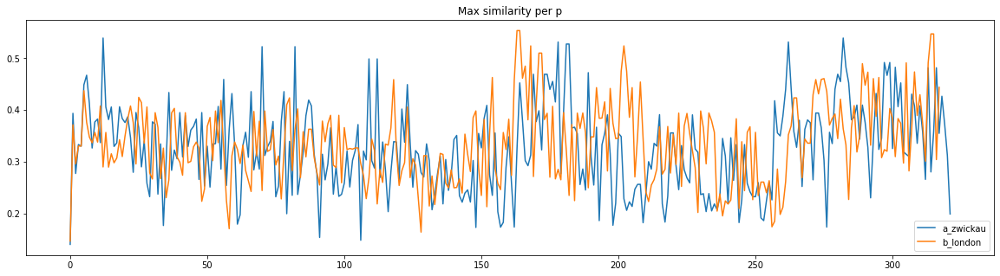

In [14]:
%matplotlib inline
fig, ax = plt.subplots(figsize=(20, 5))
ax.plot(a_zwickau_max_similarity_per_p, label="a_zwickau")
ax.plot(b_london_max_similarity_per_p, label="b_london")
ax.legend()
plt.title('Max similarity per p')
plt.show()

In [15]:
def cross_version_similarity(version_1_corpus, version_2_corpus):
    res = []
    for i, p in enumerate(version_1_corpus):
        temp_corpus = [p] + version_2_corpus
        df_features = get_features(temp_corpus)
        temp_similarities = cosine_similarity(df_features, df_features)
        res.append(temp_similarities[0])
    return res

In [16]:
a_zwickau_b_london_similarities = cross_version_similarity(a_zwickau_corpus, b_london_corpus)
b_london_a_zwickau_similarities = cross_version_similarity(b_london_corpus, a_zwickau_corpus)


In [17]:
show_similarities_data(a_zwickau_b_london_similarities)

___ max similariry for paragraph: 0 ___
index: [21] value: 0.09499431013766618
index: [263] value: 0.0984757649800135
index: [273] value: 0.1051620575449281
index: [20] value: 0.1443317461445429
index: [9] value: 0.1532578919473218
index: [0] value: 0.9999999999999999
average: 0.03151709700215145
0 similarities: 16

___ max similariry for paragraph: 1 ___
index: [276] value: 0.3494508253404262
index: [6] value: 0.3501127303642953
index: [314] value: 0.3684088139671957
index: [273] value: 0.3787306821277224
index: [2] value: 0.8608465148577484
index: [0] value: 0.9999999999999993
average: 0.2018475211777893
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [4] value: 0.2456781351580886
index: [306] value: 0.2533270704764618
index: [275] value: 0.2596155574841239
index: [6] value: 0.2686704592750902
index: [3] value: 0.899494791939106
index: [0] value: 1.0
average: 0.14639107245132066
0 similarities: 1

___ max similariry for paragraph: 3 ___
index: [193] value: 0.3180

0 similarities: None

___ max similariry for paragraph: 202 ___
index: [30] value: 0.19865155691107955
index: [260] value: 0.2013622145066044
index: [139] value: 0.2026427210461798
index: [152] value: 0.2119264781259749
index: [154] value: 0.22425457018361206
index: [0] value: 1.0000000000000002
average: 0.09338010580182061
0 similarities: None

___ max similariry for paragraph: 203 ___
index: [157] value: 0.1815240586828874
index: [241] value: 0.18641659206596567
index: [196] value: 0.19466771650933568
index: [213] value: 0.2299617783953343
index: [212] value: 0.4445122047893582
index: [0] value: 0.9999999999999999
average: 0.10394193474246848
0 similarities: None

___ max similariry for paragraph: 204 ___
index: [262] value: 0.18787967612336687
index: [209] value: 0.19970167837562677
index: [173] value: 0.210271587436073
index: [152] value: 0.21187491126895386
index: [213] value: 0.5627280010503336
index: [0] value: 1.0
average: 0.10070111368369644
0 similarities: None

___ max simil

In [18]:
show_similarities_data(b_london_a_zwickau_similarities)

___ max similariry for paragraph: 0 ___
index: [292] value: 0.0922622097234985
index: [281] value: 0.0947902098756971
index: [275] value: 0.09701711643363904
index: [195] value: 0.11602893461590602
index: [322] value: 0.12602730797637046
index: [0] value: 1.0
average: 0.030535120318678385
0 similarities: 35

___ max similariry for paragraph: 1 ___
index: [314] value: 0.34800841099047297
index: [281] value: 0.3620816677893966
index: [283] value: 0.3636776139952923
index: [7] value: 0.38323035946085615
index: [2] value: 0.8577490778974184
index: [0] value: 1.0000000000000007
average: 0.19333502861126906
0 similarities: None

___ max similariry for paragraph: 2 ___
index: [281] value: 0.2772708929922369
index: [13] value: 0.2779265203723809
index: [282] value: 0.2819842518729129
index: [6] value: 0.295879709655185
index: [3] value: 0.903163843611561
index: [0] value: 1.0000000000000004
average: 0.14787540055944653
0 similarities: None

___ max similariry for paragraph: 3 ___
index: [281] 

index: [56] value: 0.26200267329516824
index: [105] value: 0.2796868062734774
index: [88] value: 0.28309228172039164
index: [55] value: 0.29845371367106305
index: [70] value: 0.8049136109945488
index: [0] value: 1.0000000000000004
average: 0.14634417070996403
0 similarities: None

___ max similariry for paragraph: 69 ___
index: [124] value: 0.3165695004707243
index: [298] value: 0.3180629922702194
index: [170] value: 0.3425177771172142
index: [55] value: 0.36584257349337407
index: [81] value: 0.7766398359229633
index: [0] value: 1.0
average: 0.18937620281779705
0 similarities: None

___ max similariry for paragraph: 70 ___
index: [37] value: 0.20629288646837216
index: [13] value: 0.2065953508161551
index: [271] value: 0.20898598885786324
index: [85] value: 0.2197191373306742
index: [82] value: 0.7814844617386988
index: [0] value: 0.9999999999999999
average: 0.1193180767289037
0 similarities: None

___ max similariry for paragraph: 71 ___
index: [13] value: 0.419544870886102
index: [57]

0 similarities: None

___ max similariry for paragraph: 205 ___
index: [300] value: 0.39146025019113107
index: [314] value: 0.4009808850740156
index: [281] value: 0.4013642677818423
index: [170] value: 0.4228891070020068
index: [186] value: 0.4526695207241125
index: [0] value: 0.9999999999999997
average: 0.23593819443779407
0 similarities: None

___ max similariry for paragraph: 206 ___
index: [193] value: 0.23706270042564667
index: [89] value: 0.24578148886464202
index: [170] value: 0.26014295159301154
index: [267] value: 0.33032485828494956
index: [167] value: 0.4498169228037011
index: [0] value: 0.9999999999999996
average: 0.1354544140901522
0 similarities: None

___ max similariry for paragraph: 207 ___
index: [298] value: 0.2764156813322354
index: [183] value: 0.27757311664371703
index: [174] value: 0.31433747504794823
index: [170] value: 0.347445884885587
index: [268] value: 0.46598571583121184
index: [0] value: 1.0
average: 0.16337386736133552
0 similarities: None

___ max simil

0 similarities: None

___ max similariry for paragraph: 281 ___
index: [7] value: 0.37065504406217253
index: [284] value: 0.378470049519444
index: [287] value: 0.38325690282888947
index: [288] value: 0.40288547872827457
index: [290] value: 0.9248494451818363
index: [0] value: 1.0000000000000004
average: 0.18817986094448014
0 similarities: None

___ max similariry for paragraph: 282 ___
index: [283] value: 0.3423544390741914
index: [282] value: 0.3457959277060309
index: [281] value: 0.3742700094839105
index: [280] value: 0.3914037686465103
index: [291] value: 0.9144324846527172
index: [0] value: 0.9999999999999999
average: 0.1842465894604344
0 similarities: None

___ max similariry for paragraph: 283 ___
index: [87] value: 0.23439834492578537
index: [281] value: 0.2549682218481615
index: [297] value: 0.26616812145843083
index: [291] value: 0.34963439438982064
index: [292] value: 0.9509402150172428
index: [0] value: 1.0000000000000002
average: 0.13206360978188186
0 similarities: None

__

In [19]:
a_zwickau_b_london_max_similarity_per_p = get_max_similarity_per_p(a_zwickau_b_london_similarities)
b_london_a_zwickau_max_similarity_per_p = get_max_similarity_per_p(b_london_a_zwickau_similarities)

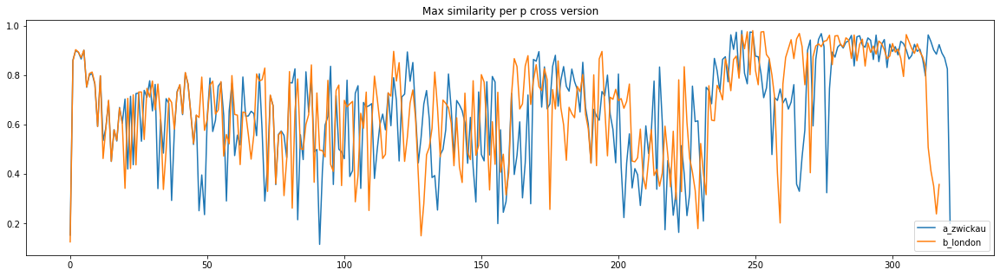

In [20]:
fig, ax = plt.subplots(figsize=(20, 5))
ax.plot(a_zwickau_b_london_max_similarity_per_p, label="a_zwickau")
ax.plot(b_london_a_zwickau_max_similarity_per_p, label="b_london")
ax.legend()
plt.title('Max similarity per p cross version')
plt.show()

In [21]:
def create_G_of_similaritis(similarities):
    G = nx.Graph()
    for index, value in enumerate(similarities):
        max_indices = thesisUtils.get_n_indexes_of_max_values(value, 6)
        max_indices_without_self = max_indices[:-1]
        G.add_node(index) # node himself
        for n in max_indices_without_self:
            G.add_node(n)
            weight = similarities[index][n]
            G.add_weighted_edges_from([(index, n, weight)])
    return G

In [22]:
def show_G(G):
    %matplotlib notebook

    fig = plt.figure(figsize=(10, 10))
    fig.canvas.manager.full_screen_toggle()

    pos=nx.spring_layout(G)
    nx.draw(
        G, 
        pos,
        with_labels=True, 
    )
    fig.show()

In [23]:
a_zwickau_G = create_G_of_similaritis(a_zwickau_similarities)
b_london_G = create_G_of_similaritis(b_london_similarities)

In [24]:
print(len(list(nx.connected_components(a_zwickau_G))))
print(len(list(nx.connected_components(b_london_G))))

1
1


In [25]:
a_zwickau_sorted_degree = sorted(a_zwickau_G.degree, key=lambda x: x[1], reverse=True)
print(a_zwickau_sorted_degree)

[(280, 94), (169, 82), (297, 69), (299, 64), (123, 50), (282, 45), (6, 38), (12, 37), (87, 35), (283, 34), (5, 29), (88, 29), (152, 27), (281, 25), (54, 24), (173, 24), (86, 23), (24, 21), (318, 20), (121, 19), (313, 18), (70, 16), (21, 16), (105, 16), (36, 16), (279, 15), (184, 15), (316, 14), (15, 14), (262, 14), (192, 14), (20, 13), (74, 13), (155, 13), (201, 13), (185, 12), (63, 12), (77, 12), (182, 12), (46, 11), (241, 11), (59, 11), (73, 11), (64, 11), (30, 11), (95, 11), (82, 11), (227, 11), (109, 11), (9, 10), (25, 10), (23, 10), (58, 10), (171, 10), (108, 10), (303, 10), (289, 9), (18, 9), (139, 9), (52, 9), (53, 9), (43, 9), (274, 9), (71, 9), (110, 9), (301, 9), (163, 9), (255, 9), (290, 9), (308, 9), (224, 9), (176, 9), (258, 9), (264, 9), (196, 9), (10, 8), (287, 8), (27, 8), (40, 8), (37, 8), (45, 8), (56, 8), (76, 8), (101, 8), (254, 8), (154, 8), (126, 8), (236, 8), (167, 8), (228, 8), (219, 8), (160, 8), (200, 8), (174, 8), (263, 8), (180, 8), (215, 8), (194, 7), (7, 7

In [26]:
b_london_sorted_degree = sorted(b_london_G.degree, key=lambda x: x[1], reverse=True)
print(b_london_sorted_degree)

[(272, 72), (80, 60), (118, 59), (313, 57), (291, 55), (162, 52), (205, 51), (192, 48), (25, 34), (289, 33), (275, 32), (274, 28), (310, 28), (83, 28), (71, 28), (5, 27), (208, 24), (305, 22), (163, 22), (273, 21), (151, 20), (55, 20), (31, 19), (98, 18), (82, 17), (51, 17), (164, 17), (147, 15), (233, 15), (231, 15), (271, 14), (26, 14), (176, 14), (94, 14), (153, 13), (197, 12), (160, 12), (74, 12), (100, 12), (218, 12), (209, 11), (59, 11), (148, 11), (308, 11), (174, 11), (166, 11), (46, 10), (88, 10), (67, 10), (222, 10), (28, 10), (73, 10), (92, 10), (69, 10), (117, 10), (216, 10), (202, 10), (20, 9), (9, 9), (37, 9), (50, 9), (123, 9), (54, 9), (93, 9), (314, 9), (295, 9), (261, 9), (282, 9), (317, 8), (21, 8), (6, 8), (18, 8), (13, 8), (27, 8), (11, 8), (34, 8), (187, 8), (56, 8), (49, 8), (53, 8), (315, 8), (62, 8), (101, 8), (106, 8), (102, 8), (134, 8), (234, 8), (172, 8), (165, 8), (203, 8), (204, 8), (183, 8), (288, 8), (311, 7), (19, 7), (115, 7), (79, 7), (24, 7), (38, 7

In [27]:
a_zwickau_strongly_connected_nodes = [(node, degree) for node, degree in a_zwickau_sorted_degree if degree >= 10]
print(len(a_zwickau_strongly_connected_nodes))
print(a_zwickau_strongly_connected_nodes)

56
[(280, 94), (169, 82), (297, 69), (299, 64), (123, 50), (282, 45), (6, 38), (12, 37), (87, 35), (283, 34), (5, 29), (88, 29), (152, 27), (281, 25), (54, 24), (173, 24), (86, 23), (24, 21), (318, 20), (121, 19), (313, 18), (70, 16), (21, 16), (105, 16), (36, 16), (279, 15), (184, 15), (316, 14), (15, 14), (262, 14), (192, 14), (20, 13), (74, 13), (155, 13), (201, 13), (185, 12), (63, 12), (77, 12), (182, 12), (46, 11), (241, 11), (59, 11), (73, 11), (64, 11), (30, 11), (95, 11), (82, 11), (227, 11), (109, 11), (9, 10), (25, 10), (23, 10), (58, 10), (171, 10), (108, 10), (303, 10)]


In [28]:
b_london_strongly_connected_nodes = [(node, degree) for node, degree in b_london_sorted_degree if degree >= 10]
print(len(b_london_strongly_connected_nodes))
print(b_london_strongly_connected_nodes)

57
[(272, 72), (80, 60), (118, 59), (313, 57), (291, 55), (162, 52), (205, 51), (192, 48), (25, 34), (289, 33), (275, 32), (274, 28), (310, 28), (83, 28), (71, 28), (5, 27), (208, 24), (305, 22), (163, 22), (273, 21), (151, 20), (55, 20), (31, 19), (98, 18), (82, 17), (51, 17), (164, 17), (147, 15), (233, 15), (231, 15), (271, 14), (26, 14), (176, 14), (94, 14), (153, 13), (197, 12), (160, 12), (74, 12), (100, 12), (218, 12), (209, 11), (59, 11), (148, 11), (308, 11), (174, 11), (166, 11), (46, 10), (88, 10), (67, 10), (222, 10), (28, 10), (73, 10), (92, 10), (69, 10), (117, 10), (216, 10), (202, 10)]


<IPython.core.display.Javascript object>


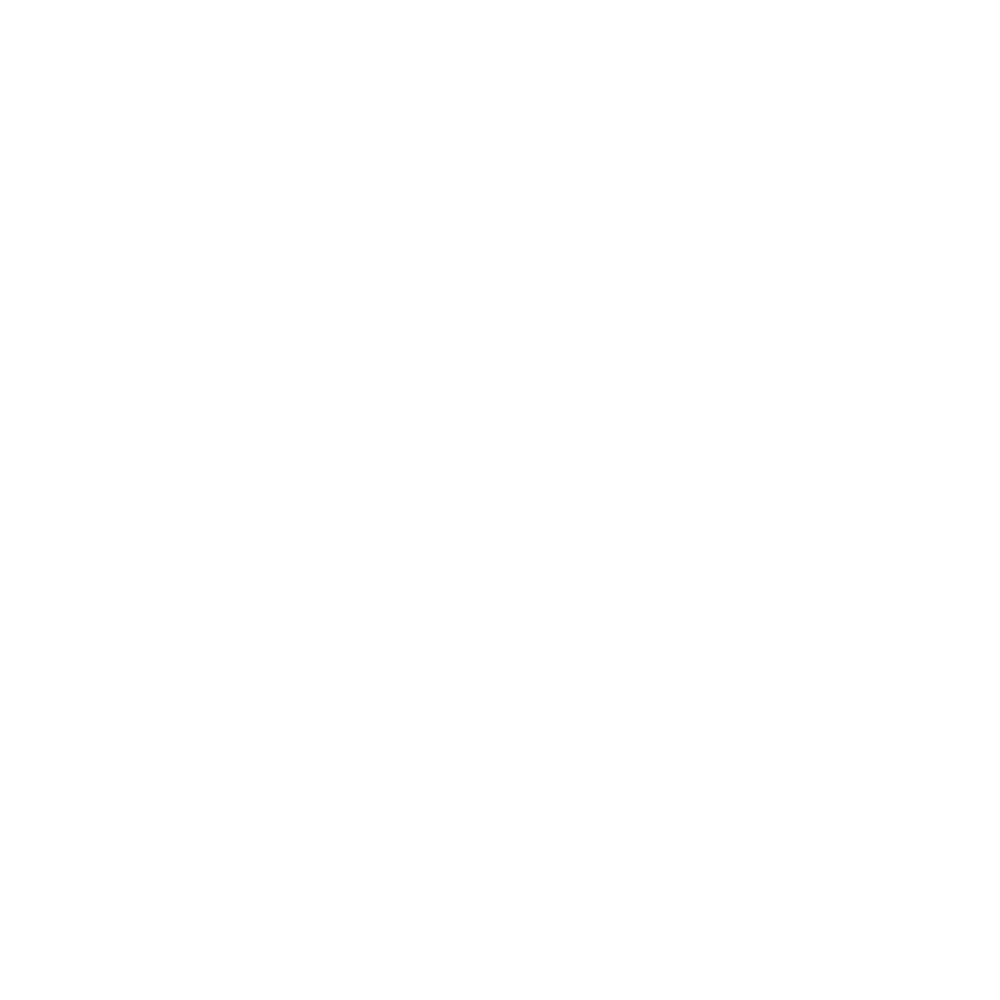

In [29]:
show_G(a_zwickau_G)

<IPython.core.display.Javascript object>


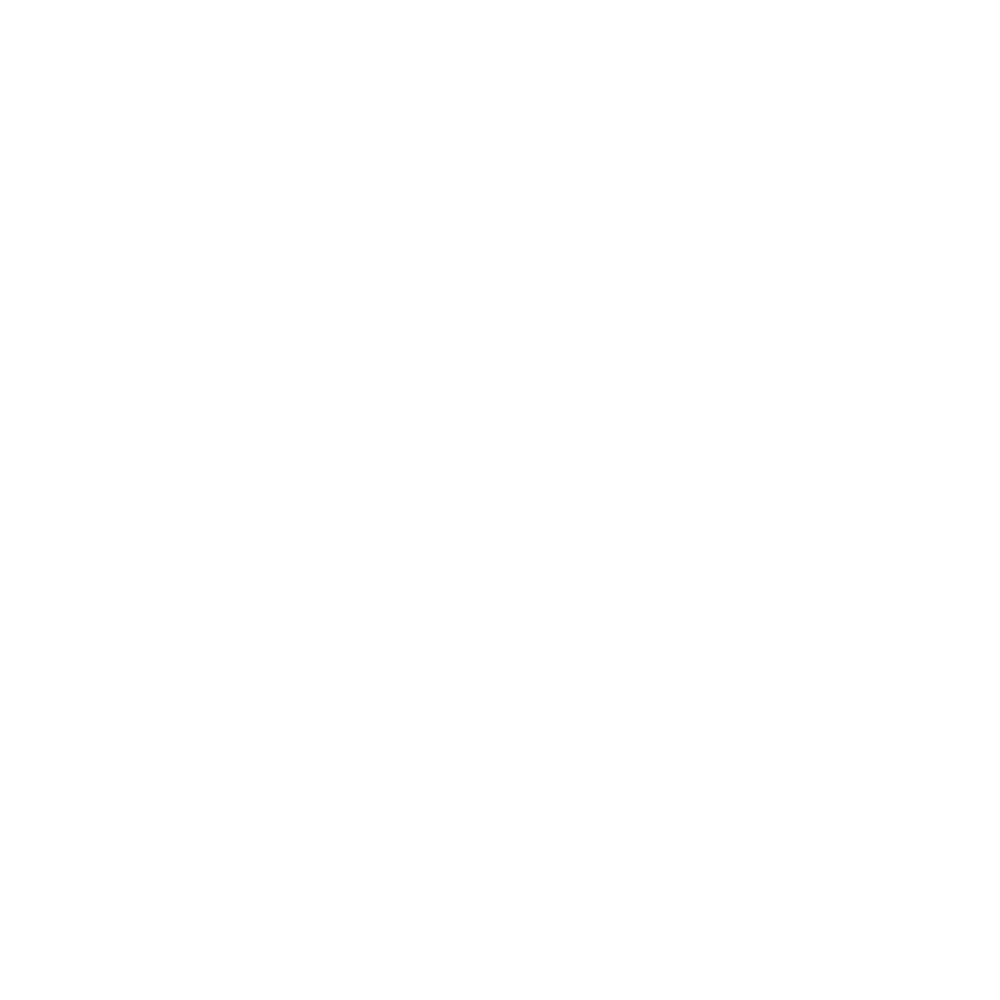

In [30]:
show_G(b_london_G)

In [31]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(20,900))
a_zwickau_similarities_df = pd.DataFrame(a_zwickau_similarities)
b_london_similarities_df = pd.DataFrame(b_london_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(a_zwickau_similarities_df.index):
        y_1 = a_zwickau_similarities_df.iloc[i, :]
        ax.plot(y_1, color='orange', label='a_zwickau')
    
    if i in list(b_london_similarities_df.index):
        y_2 = b_london_similarities_df.iloc[i, :]
        ax.plot(y_2, label='b_london')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()

In [32]:
%matplotlib inline
fig, axes = plt.subplots(318, 1, figsize=(20,900))
a_zwickau_similarities_df = pd.DataFrame(a_zwickau_b_london_similarities)
b_london_similarities_df = pd.DataFrame(b_london_a_zwickau_similarities)

for i, ax in enumerate(axes.ravel()):
    ax.set_title(f'paragraph {i}')
    
    if i in list(a_zwickau_similarities_df.index):
        y_1 = a_zwickau_similarities_df.iloc[i,:]
        ax.plot(y_1, color='orange', label='a_zwickau')
    
    if i in list(b_london_similarities_df.index):
        y_2 = b_london_similarities_df.iloc[i,:]
        ax.plot(y_2, label='b_london')
        
    ax.grid()
    ax.set_ylim([0,1])
    ax.legend()

plt.show()